In [31]:
from lra_benchmarks.data.pathfinder import Pathfinder32

In [9]:
# Set up a dataset directory where the dataset will be stored
dataset_dir = '/home/giuseppe/dataset'

# Generate the dataset
builder = Pathfinder32()  # Or Pathfinder64, Pathfinder128, Pathfinder256 depending on your needs
builder.download_and_prepare(download_dir=dataset_dir)

# Load the dataset
datasets = builder.as_dataset()

# `datasets` will be a dictionary with keys 'train', 'test', etc., depending on your splits


Generating splits...:   0%|          | 0/3 [00:00<?, ? splits/s]

**************************** WARNING *********************************
yet no `beam_runner` nor `beam_options` was explicitly provided.

Some Beam datasets take weeks to generate, so are usually not suited
for single machine generation. Please have a look at the instructions
to setup distributed generation:

https://www.tensorflow.org/datasets/beam_datasets#generating_a_beam_dataset
**********************************************************************


200
200
200


2024-02-25 19:09:29.420240: I external/local_xla/xla/stream_executor/cuda/cuda_diagnostics.cc:129] retrieving CUDA diagnostic information for host: powerprof-VivoBook
2024-02-25 19:09:29.420255: I external/local_xla/xla/stream_executor/cuda/cuda_diagnostics.cc:136] hostname: powerprof-VivoBook
2024-02-25 19:09:29.420309: I external/local_xla/xla/stream_executor/cuda/cuda_diagnostics.cc:159] libcuda reported version is: NOT_FOUND: was unable to find libcuda.so DSO loaded into this program
2024-02-25 19:09:29.420332: I external/local_xla/xla/stream_executor/cuda/cuda_diagnostics.cc:163] kernel reported version is: 525.147.5


['imgs/130 sample_0.png 0 1 1.0 9 3.0 2 0.5 1 1', 'imgs/130 sample_1.png 1 1 1.0 9 3.0 2 0.5 1 1', 'imgs/130 sample_2.png 2 1 1.0 9 3.0 2 0.5 1 1', 'imgs/130 sample_3.png 3 0 1.0 9 3.0 2 0.5 1 1', 'imgs/130 sample_4.png 4 0 1.0 9 3.0 2 0.5 1 1', 'imgs/130 sample_5.png 5 0 1.0 9 3.0 2 0.5 1 1', 'imgs/130 sample_6.png 6 1 1.0 9 3.0 2 0.5 1 1', 'imgs/130 sample_7.png 7 0 1.0 9 3.0 2 0.5 1 1', 'imgs/130 sample_8.png 8 0 1.0 9 3.0 2 0.5 1 1', 'imgs/130 sample_9.png 9 0 1.0 9 3.0 2 0.5 1 1', 'imgs/130 sample_10.png 10 0 1.0 9 3.0 2 0.5 1 1', 'imgs/130 sample_11.png 11 0 1.0 9 3.0 2 0.5 1 1', 'imgs/130 sample_12.png 12 0 1.0 9 3.0 2 0.5 1 1', 'imgs/130 sample_13.png 13 0 1.0 9 3.0 2 0.5 1 1', 'imgs/130 sample_14.png 14 1 1.0 9 3.0 2 0.5 1 1', 'imgs/130 sample_15.png 15 0 1.0 9 3.0 2 0.5 1 1', 'imgs/130 sample_16.png 16 0 1.0 9 3.0 2 0.5 1 1', 'imgs/130 sample_17.png 17 1 1.0 9 3.0 2 0.5 1 1', 'imgs/130 sample_18.png 18 0 1.0 9 3.0 2 0.5 1 1', 'imgs/130 sample_19.png 19 0 1.0 9 3.0 2 0.5 1 1',

In [11]:
dataset = datasets['easy']

In [12]:
for example in dataset.take(1):  # Takes one example from the dataset
    image, label = example['image'], example['label']
    print("Image shape:", image.shape)
    print("Label:", label.numpy())
    

Image shape: (32, 32, 3)
Label: 1


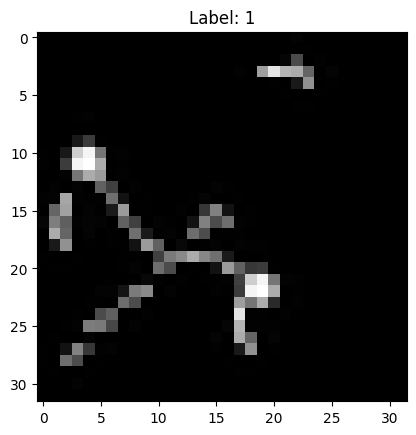

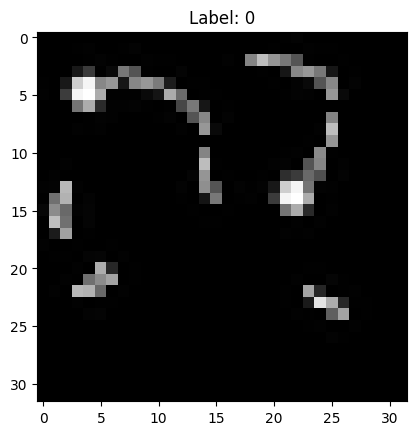

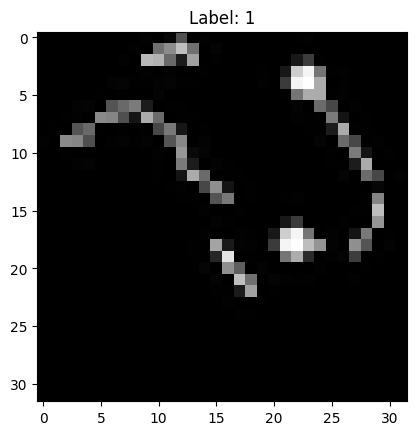

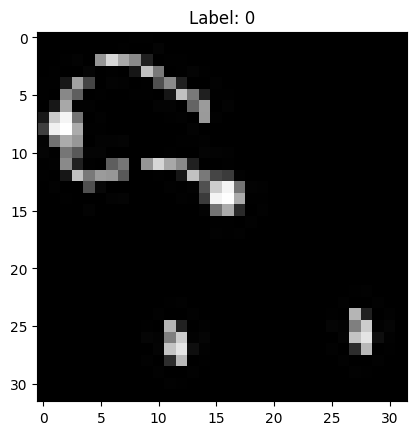

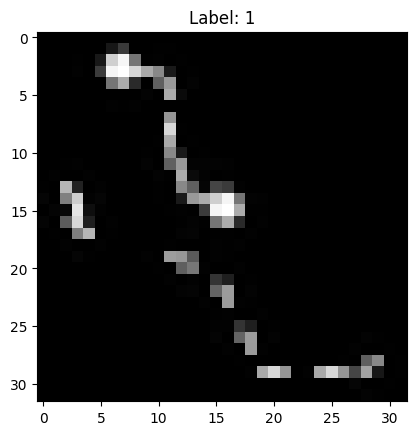

In [43]:
import matplotlib.pyplot as plt

for example in dataset.take(5):  # Takes one example from the dataset
    image, label = example['image'], example['label']
    plt.imshow(image.numpy())
    plt.title(f"Label: {label.numpy()}")
    plt.show()

In [28]:
print(dataset)

<_PrefetchDataset element_spec={'image': TensorSpec(shape=(None, None, 3), dtype=tf.uint8, name=None), 'label': TensorSpec(shape=(), dtype=tf.int64, name=None)}>


In [58]:
from src.models.s4.s4d import S4D
num_features = image.shape[2]
s4d_model = S4D(d_model=num_features)

In [50]:
import tensorflow as tf
import torch

img = tf.reshape(image, (image.shape[2], image.shape[0]*image.shape[1]))
img = tf.expand_dims(img, axis=0)  # Add batch dimension

# Step 2: Convert the reshaped TensorFlow tensor to a PyTorch tensor
img = torch.from_numpy(img.numpy())


In [53]:
img.shape

torch.Size([1, 3, 1024])

In [56]:
s4d_model(img)

(tensor([[[-0.0078, -0.0825, -0.0628,  ...,  0.9117,  0.3702,  0.2077],
          [-0.1416, -0.2371, -0.2083,  ..., -0.0272, -0.0091, -0.1412],
          [ 0.2711,  0.3123,  0.3000,  ...,  4.9803,  6.9831,  3.6563]]],
        grad_fn=<GluBackward0>),
 None)